## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [54]:
%%time
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt
nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
no_img=0
img_size = 0
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)
        no_img += 1
        img_size = (gray.shape[1], gray.shape[0])
cv2.destroyAllWindows()
print("no of image processed successfully:", no_img)
print("Image processed Size:", img_size)


no of image processed successfully: 17
Image processed Size: (1280, 720)
Wall time: 30.7 s


In [7]:
import pickle

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
dist_pickle["rvecs"] = rvecs
dist_pickle["tvecs"] = tvecs
pickle.dump( dist_pickle, open( "Project_cam_dist_pickle.p", "wb" ) )

True

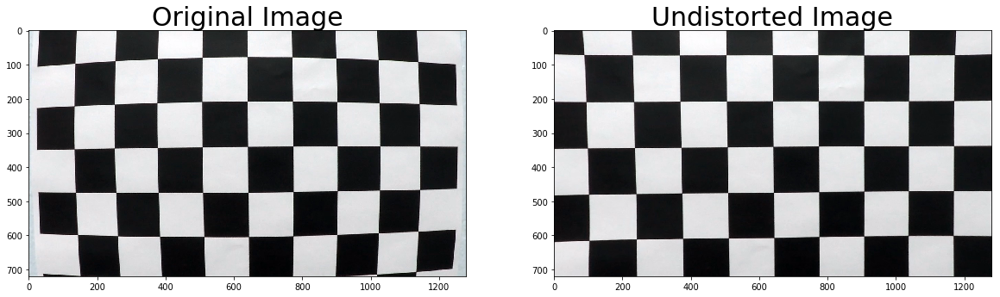

In [9]:
%matplotlib inline
# Test undistortion on an image
img = cv2.imread('camera_cal/calibration1.jpg')


dst = cv2.undistort(img, mtx, dist, None, mtx)
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

cv2.imwrite('calibration1_undistorted.jpg',dst)

In [49]:
import pickle
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Read in the saved camera matrix and distortion coefficients
# These are the arrays you calculated using cv2.calibrateCamera()
dist_pickle = pickle.load( open( "Project_cam_dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
images = glob.glob('test_images/*.jpg')
# Read in an image

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

In [67]:
print(images)


['test_images\\straight_lines1.jpg', 'test_images\\straight_lines2.jpg', 'test_images\\test1.jpg', 'test_images\\test2.jpg', 'test_images\\test3.jpg', 'test_images\\test4.jpg', 'test_images\\test5.jpg', 'test_images\\test6.jpg']


### Distortion correction

In [127]:
def un_distort(img):
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst

In [127]:
# i = 7
# fig, axs = plt.subplots(1, 2, figsize=(14, 7))
# axs = axs.ravel()

# img = cv2.imread(images[i])
# un_dst = un_distort(img)
# axs[0].imshow(np.flip(img,2))
# axs[1].imshow(np.flip(un_dst,2))

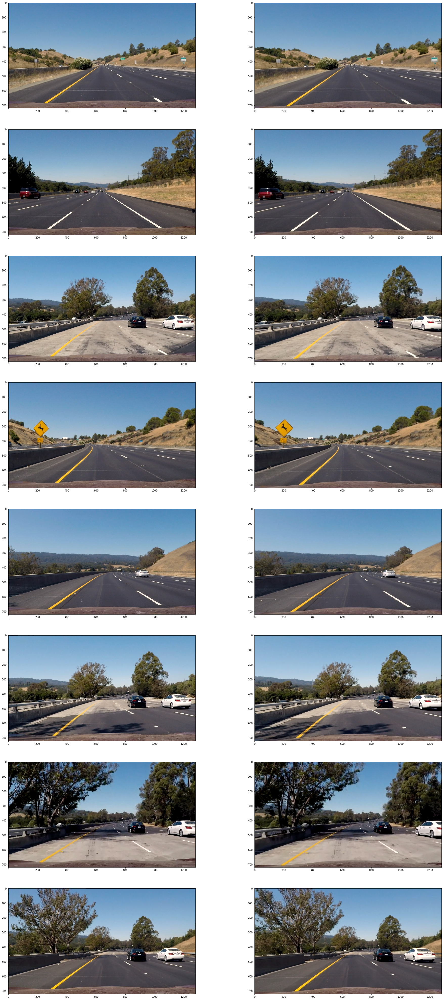

In [144]:
no_test_imgs = len(images)
fig, axs = plt.subplots(no_test_imgs, 2, figsize=(16*2, 9*no_test_imgs))
un_dst_img=[]
axs = axs.ravel()
for i in range(no_test_imgs):
    img = cv2.imread(images[i])
    un_dst_img.append(un_distort(img))
    axs[i*2].imshow(np.flip(img,2))
    axs[i*2+1].imshow(np.flip(un_dst_img[i],2))

### Color and Gradient

In [ ]:
def detect_color_gradient(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,2]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # plt.hist(s_channel)
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    # color_binary = np.uint8(np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255)
    color_binary = np.uint8(np.dstack(( np.zeros_like(sxbinary), sxbinary, np.zeros_like(sxbinary))) * 255)

    binary_img = np.zeros_like(s_channel)
    binary_img[(s_channel ==1) | (sxbinary ==1)] = 1
    binary_img = np.uint8(binary_img* 255)
#     color_binary = np.uint8(np.dstack(( binary_img, binary_img, binary_img)) * 255)
#     binary_img = np.bitwise_or(sxbinary, s_binary)
    return binary_img
#     return color_binary

# i = 0
# fig, axs = plt.subplots(1, 2, figsize=(14, 7))
# axs = axs.ravel()

# # img = cv2.imread(images[i])
# # gradient_img = detect_color_gradient(img)
# gradient_img = detect_color_gradient(un_dst)
# axs[i*2].imshow(np.flip(img,2))
# axs[i*2+1].imshow(gradient_img)


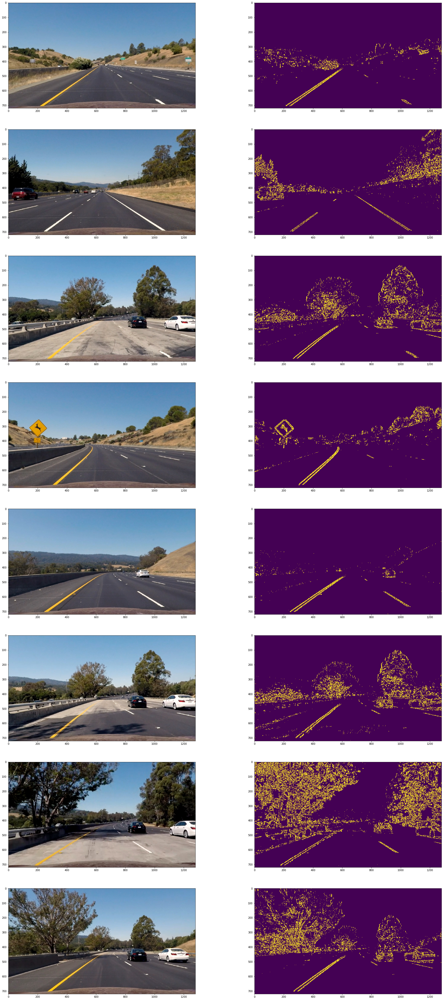

In [145]:
## plot gradient test images
fig, axs = plt.subplots(no_test_imgs, 2, figsize=(16*2, 9*no_test_imgs))
gradient_img=[]
axs = axs.ravel()
for i in range(no_test_imgs):
#     img = cv2.imread(images[i])
    gradient_img.append(detect_color_gradient(un_dst_img[i]))
    axs[i*2].imshow(np.flip(un_dst_img[i],2))
    axs[i*2+1].imshow(gradient_img[i])

### Prespective Transform

In [148]:
src1 = np.float32([ [580, 460 ], [180, 720 ], [1220, 720], [730, 460 ]])
dst1 = np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])

def prespective_transform(img, src=src1, dst=dst1):
    
    # cv2.getPerspectiveTransform() to get M, Minv the transform matrix
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # cv2.warpPerspective() to warp your image to a top-down view
    # print(img.shape[1::-1])
    warped = cv2.warpPerspective(img, M, (960, 720), flags=cv2.INTER_LINEAR)

    return warped, M, Minv
    

In [ ]:
i = 0

fig, axs = plt.subplots(1, 2, figsize=(14, 7))
axs = axs.ravel()

# img = cv2.imread(images[i])
# gradient_img = detect_color_gradient(img)

src = np.float32([ [580, 460 ], [180, 720 ], [1220, 720], [730, 460 ]])
dst = np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])
warped_img, M, Minv = prespective_transform(gradient_img, src, dst)
 
axs[i*2].imshow(gradient_img)

axs[i*2+1].imshow(warped_img)

print(warped_img.shape)    

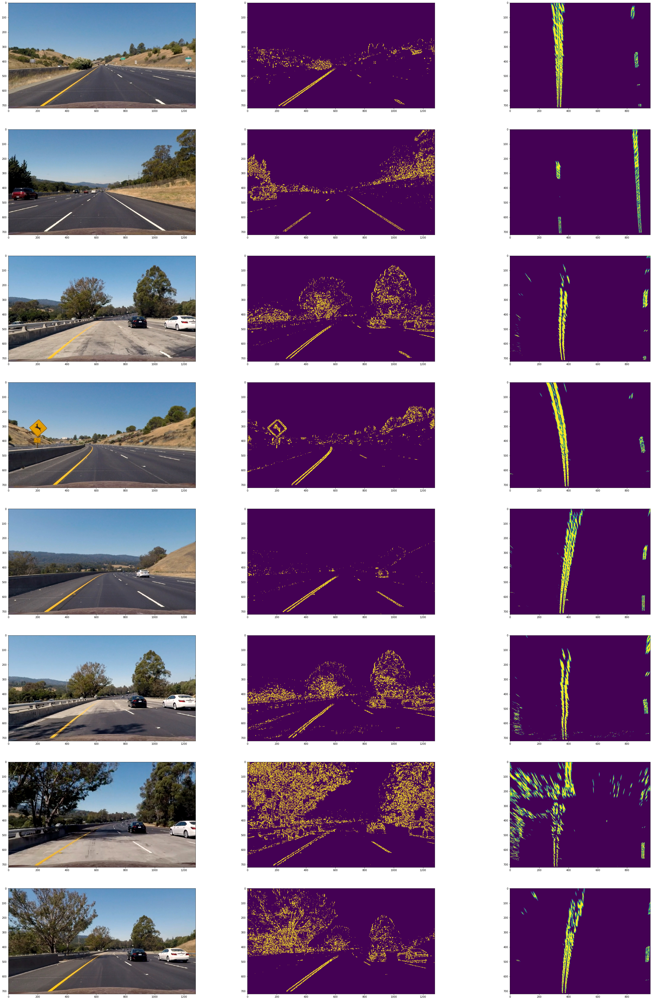

In [149]:
# plot prespective transform
fig, axs = plt.subplots(no_test_imgs, 3, figsize=(16*3, 9*no_test_imgs))
warped_img=[]
M =[] 
Minv =[]
axs = axs.ravel()
for i in range(no_test_imgs):
#     img = cv2.imread(images[i])
    wp_img, M, Minv = prespective_transform(gradient_img[i])
    warped_img.append(wp_img)
    axs[i*3].imshow(np.flip(un_dst_img[i],2))
    axs[i*3+1].imshow(gradient_img[i])
    axs[i*3+2].imshow(warped_img[i])

In [150]:
def detect_lane(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # out_img =binary_warped
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint


    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & \
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & \
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)



    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    ### visvulatization for debugging

#     out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
#     out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
#     plt.imshow(out_img)
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
#     plt.xlim(0, 1280)
#     plt.ylim(720, 0)


    return ploty, left_fitx, right_fitx

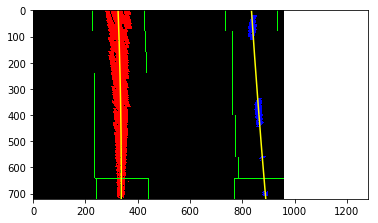

In [132]:
##calling function
ploty, left_fitx, right_fitx = detect_lane(wraped_img)

In [151]:
def draw_lanes(undist, warped, ploty, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    return result


# plt.imshow(draw_lanes(np.flip(un_dst,2), warped_img, ploty, left_fitx, right_fitx))    
    

In [152]:
def pipeline_image_processing(img): 
    undistort_img = un_distort(img)
    binary_img1 = detect_color_gradient(undistort_img, s_thresh=(170, 255), sx_thresh=(20, 100))
    
#     src = np.float32([ [585, 460 ], [203, 720 ], [1127, 720], [695, 460 ]])
#     dst  =np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])
    
    src = np.float32([ [580, 460 ], [180, 720 ], [1220, 720], [730, 460 ]])
    dst  =np.float32( [[320, 0 ], [320, 720 ], [960, 720], [960, 0 ]])
    warped_img, M, Minv = prespective_transform(binary_img1, src, dst)
    ploty, left_fitx, right_fitx = detect_lane(warped_img)
    result = draw_lanes(undistort_img, warped_img,ploty, left_fitx, right_fitx)
    
    return result
    

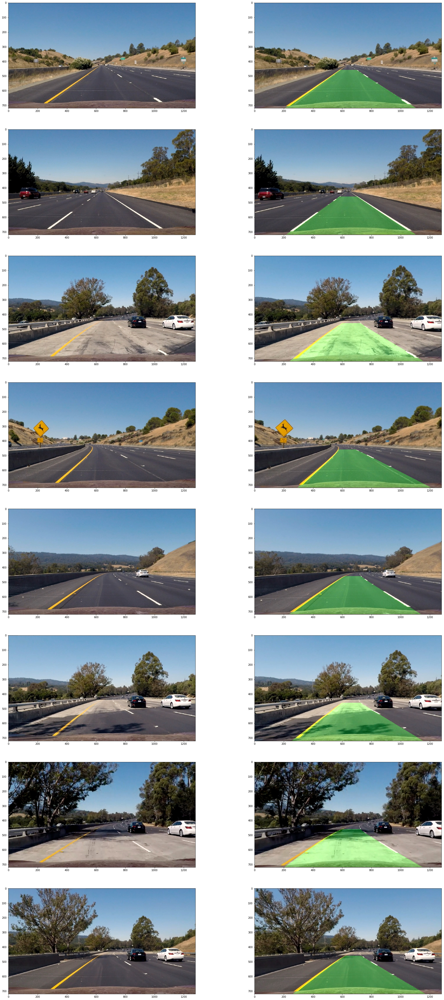

In [153]:

i = 1
no_test_imgs = len(images)
fig, axs = plt.subplots(no_test_imgs, 2, figsize=(16*2, 9*no_test_imgs))

axs = axs.ravel()
for i in range(no_test_imgs):
    img = cv2.imread(images[i])
    final_img = pipeline_image_processing(img)
    axs[i*2].imshow(np.flip(img,2))
    axs[i*2+1].imshow(np.flip(final_img,2))

# fig.imshow(np.flip(img,2))

In [154]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [157]:
vid_output = 'test_videos_output/project_video_d1_full.mp4'
# averaging lanes over image frames

# averging_over_frames = np.empty((0,7), int)  #queue to store lane coordintes for averaging over no. of frames(given by 'no_frame_avg')
# no_frame_avg = 20  # this indicate the number on frames to average the lanes over
# slope_change_restriction='n'

# clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
output_clip = clip1.fl_image(pipeline_image_processing) #NOTE: this function expects color images!!

%time output_clip.write_videofile(vid_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video_d1_full.mp4
[MoviePy] Writing video test_videos_output/project_video_d1_full.mp4


100%|█████████████████████████████████████▉| 1260/1261 [04:50<00:00,  4.96it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video_d1_full.mp4 

Wall time: 4min 52s


In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(vid_output))